# Визуализация данных с Matplotlib и Seaborn

#### Признаки могут быть следующих видов:

- **Бинарные**, которые принимают только два значения. Например, [true, false], [0,1], [“да”, “нет”].
- **Категориальные (или же номинальные)**. Они имеют конечное количество уровней, например, признак «день недели» имеет 7 уровней: понедельник, вторник и т. д. до воскресенья.
- **Упорядоченные**. В некоторой степени похожи на категориальные признаки. Разница между ними в том, что данном случае существует четкое упорядочивание категорий. Например, «классы в школе» от 1 до 11. Сюда же можно отнести «время суток», которое имеет 24 уровня и является упорядоченным.
- **Числовые (количественные)**. Это значения в диапазоне от минус бесконечности до плюс бесконечности, которые нельзя отнести к предыдущим трем типам признаков.

## Подключение библиотек

In [1]:
import numpy as np
import pandas as pd

In [2]:
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
df = pd.read_csv('bank.csv')
df.sample(n=10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit
5291,48,blue-collar,married,secondary,no,238,yes,yes,cellular,2,jun,118,2,81,1,success,no
1052,30,services,single,secondary,no,495,yes,no,cellular,21,nov,641,1,-1,0,unknown,yes
5999,32,technician,single,tertiary,no,514,yes,yes,cellular,7,may,138,1,168,1,failure,no
7978,42,housemaid,married,unknown,no,302,yes,no,cellular,11,jul,342,2,-1,0,unknown,no
10291,37,technician,married,secondary,no,494,yes,no,cellular,2,feb,247,2,269,3,failure,no
5039,64,retired,divorced,primary,no,315,no,no,cellular,17,feb,154,1,-1,0,unknown,yes
618,46,housemaid,married,secondary,no,271,yes,no,cellular,30,jul,1013,29,-1,0,unknown,yes
7334,48,blue-collar,married,primary,no,816,yes,no,cellular,31,jul,114,7,-1,0,unknown,no
9231,37,admin.,married,secondary,no,1396,yes,no,cellular,22,jul,199,2,-1,0,unknown,no
2047,35,blue-collar,married,secondary,no,205,yes,yes,cellular,15,may,1313,7,312,1,failure,yes


In [4]:
def monthes(x):
    dict1 = {'jan': 1,
            'feb': 2,
            'mar': 3,
            'apr': 4,
            'may': 5,
            'jun': 6,
            'jul': 7,
            'aug': 8,
            'sep': 9,
            'oct': 10,
            'nov': 11,
            'dec': 12}
    return dict1[x]


df['month2'] = df.month.apply(monthes)
df.sample(10)

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit,month2
10547,32,admin.,married,secondary,no,57,no,yes,cellular,22,jul,50,2,-1,0,unknown,no,7
5465,36,blue-collar,married,primary,no,21,no,no,telephone,20,nov,35,1,-1,0,unknown,no,11
7515,38,services,single,primary,no,3715,yes,no,telephone,13,may,41,2,327,17,failure,no,5
5209,41,blue-collar,divorced,primary,no,664,no,yes,cellular,15,jul,955,5,-1,0,unknown,yes,7
10723,50,services,single,secondary,no,1716,yes,no,cellular,7,apr,272,1,-1,0,unknown,no,4
8123,34,technician,married,secondary,no,260,yes,no,cellular,17,apr,20,2,238,2,failure,no,4
11013,47,services,married,unknown,no,4822,yes,no,unknown,21,may,154,5,-1,0,unknown,no,5
6365,50,management,married,tertiary,no,0,no,no,cellular,10,aug,232,3,130,3,other,no,8
5471,40,blue-collar,single,unknown,no,24,yes,no,unknown,5,may,185,1,-1,0,unknown,no,5
4749,27,technician,single,secondary,no,1742,yes,no,unknown,16,may,787,1,-1,0,unknown,yes,5


In [5]:
data1 = df.groupby('month2')['age'].agg(count='count').reset_index().sort_values(by='month2')
data1

,month2,count
0,1,344
1,2,776
2,3,276
3,4,923
4,5,2824
5,6,1222
6,7,1514
7,8,1519
8,9,319
9,10,392


#### Линейная диаграмма

Text(0, 0.5, 'Кол-во клиентов')

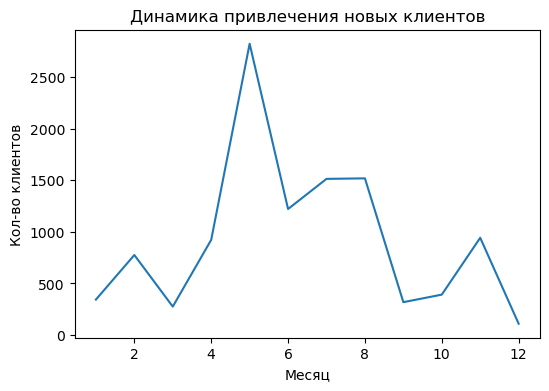

In [6]:
plt.figure(figsize=(6, 4))

plt.plot(data1['month2'], data1['count'])

plt.title('Динамика привлечения новых клиентов')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов')

Text(0, 0.5, 'Кол-во клиентов')

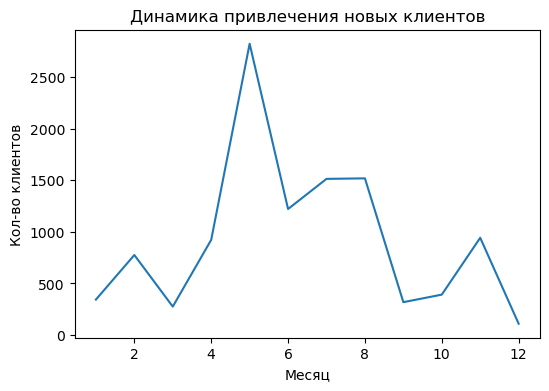

In [7]:
plt.figure(figsize=(6, 4))

sns.lineplot(x=data1['month2'], y=data1['count'])

plt.title('Динамика привлечения новых клиентов')
plt.xlabel('Месяц')
plt.ylabel('Кол-во клиентов')

#### Гистограмма

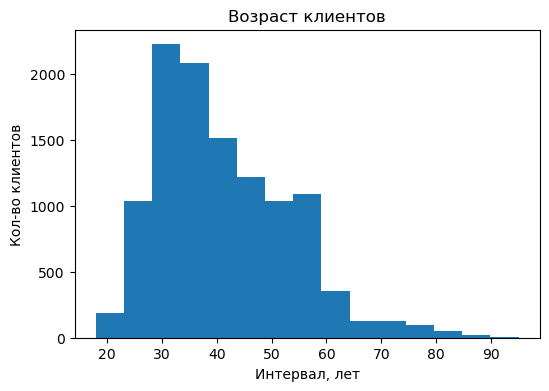

In [8]:
plt.figure(figsize=(6, 4))

plt.hist(df['age'], bins=15)

plt.title('Возраст клиентов')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');

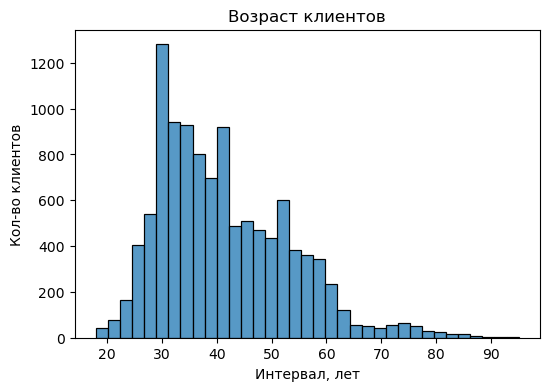

In [9]:
plt.figure(figsize=(6, 4))

sns.histplot(df['age'], bins=35)

plt.title('Возраст клиентов')
plt.xlabel('Интервал, лет')
plt.ylabel('Кол-во клиентов');

#### Диаграмма рассеяния

In [10]:
data2 = df[df.poutcome == 'success'].groupby('age')['poutcome'].count().reset_index()
data2.loc['Total'] = data2.sum()
data2

,age,poutcome
0,18,2
1,19,4
2,20,3
3,21,7
4,22,10
...,...,...
66,84,1
67,86,1
68,92,1
69,93,2


In [11]:
df.poutcome.value_counts()

unknown    8326
failure    1228
success    1071
other       537
Name: poutcome, dtype: int64

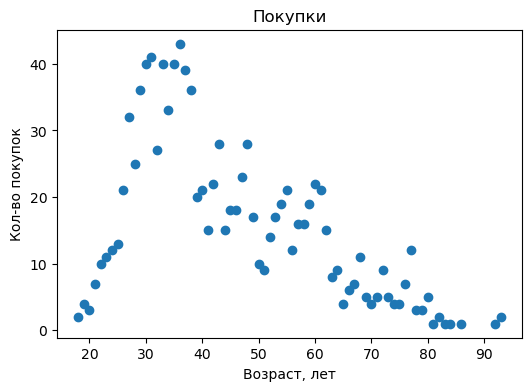

In [12]:
plt.figure(figsize=(6, 4))

plt.scatter(data2['age'][0:-1], data2.poutcome[0:-1])

plt.title('Покупки')
plt.xlabel('Возраст, лет')
plt.ylabel('Кол-во покупок');

In [13]:
data3 = df.job.value_counts().reset_index()
data3.head()

,index,job
0,management,2566
1,blue-collar,1944
2,technician,1823
3,admin.,1334
4,services,923


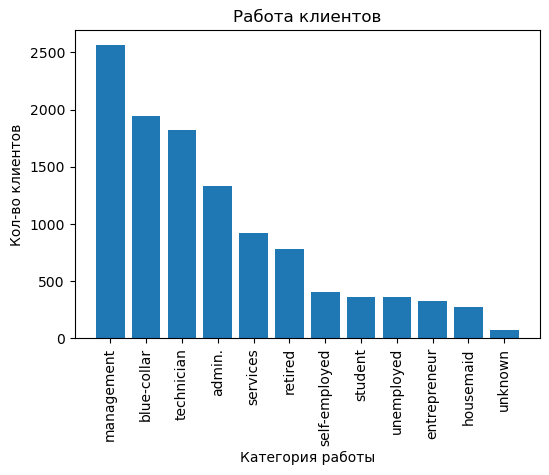

In [14]:
plt.figure(figsize=(6, 4))

plt.bar(data3['index'], data3.job)

plt.title('Работа клиентов')
plt.xlabel('Категория работы')
plt.ylabel('Кол-во клиентов')
plt.xticks(rotation=90);

#### Многорядовые столбчатые диаграммы

In [15]:
data4 = pd.crosstab(df.job, df.poutcome).reset_index().sort_values(by='success', ascending=False)
data4

poutcome,job,failure,other,success,unknown
4,management,293,141,292,1840
9,technician,208,81,157,1377
5,retired,73,36,135,534
0,admin.,185,70,134,945
1,blue-collar,190,91,90,1573
8,student,43,33,67,217
7,services,99,36,62,726
10,unemployed,35,11,52,259
6,self-employed,38,22,38,307
3,housemaid,21,9,22,222


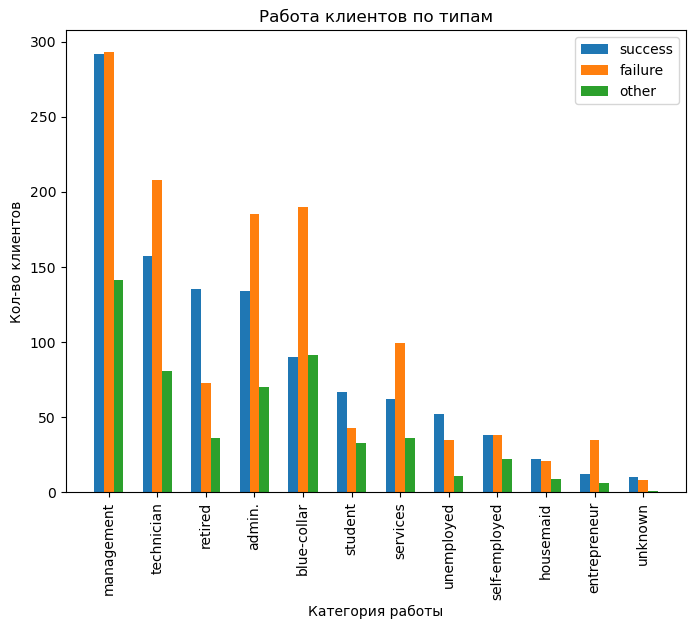

In [16]:
plt.figure(figsize=(8, 6))

n_ticks = np.arange(len(data4.job))
offset = 0.2

w = 0.2

plt.bar(n_ticks - offset, data4['success'], width=w)
plt.bar(n_ticks, data4['failure'], width=w)
plt.bar(n_ticks + offset, data4['other'], width=w)

plt.title('Работа клиентов по типам')
plt.xlabel('Категория работы')
plt.ylabel('Кол-во клиентов')
plt.xticks(n_ticks, data4.job, rotation=90)
plt.legend(['success', 'failure', 'other']);

In [17]:
data5 = pd.crosstab(df.job, df.poutcome, normalize='index').reset_index().sort_values(by='success', ascending=False)
data5.style.format(precision=2)

poutcome,job,failure,other,success,unknown
8,student,0.12,0.09,0.19,0.60
5,retired,0.09,0.05,0.17,0.69
10,unemployed,0.10,0.03,0.15,0.73
11,unknown,0.11,0.01,0.14,0.73
4,management,0.11,0.05,0.11,0.72
0,admin.,0.14,0.05,0.10,0.71
6,self-employed,0.09,0.05,0.09,0.76
9,technician,0.11,0.04,0.09,0.76
3,housemaid,0.08,0.03,0.08,0.81
7,services,0.11,0.04,0.07,0.79


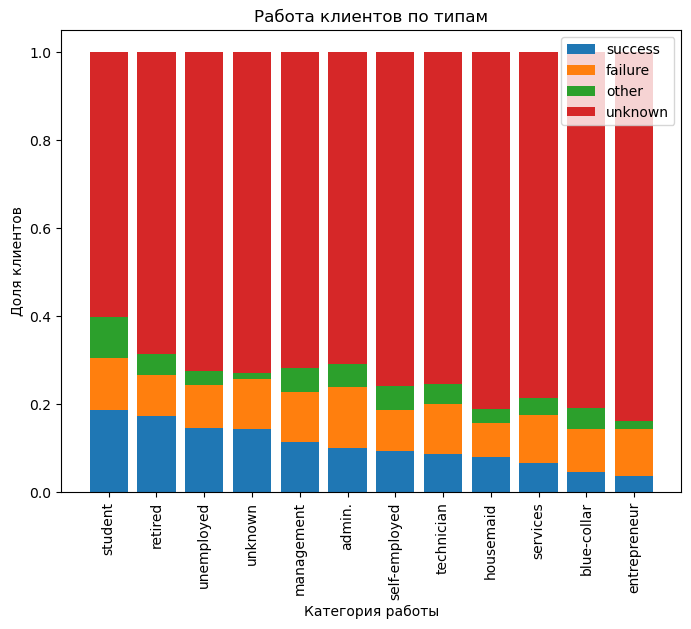

In [18]:
plt.figure(figsize=(8, 6))

plt.bar(data5.job, data5['success'])
plt.bar(data5.job, data5['failure'], bottom=data5.success)
plt.bar(data5.job, data5['other'], bottom=data5.failure+data5.success)
plt.bar(data5.job, data5['unknown'], bottom=data5.other+data5.failure+data5.success)

plt.title('Работа клиентов по типам')
plt.xlabel('Категория работы')
plt.ylabel('Доля клиентов')
plt.xticks(n_ticks, data5.job, rotation=90)
plt.legend(['success', 'failure', 'other', 'unknown']);

#### Ящики с усами

In [19]:
data6 = df.duration[df.poutcome == 'success']
data7 = df.duration[df.poutcome != 'success']
pd.DataFrame(data6).reset_index().set_index('index')

,duration
index,
899,518
951,1091
985,522
994,639
1151,182
...,...
10798,1152
10911,263
10918,450


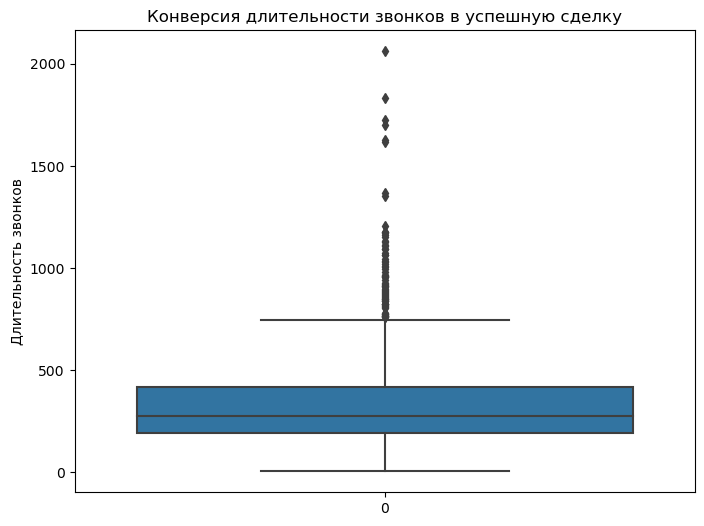

In [20]:
plt.figure(figsize=(8, 6))

sns.boxplot(data=[data6])

plt.title('Конверсия длительности звонков в успешную сделку')
plt.ylabel('Длительность звонков');

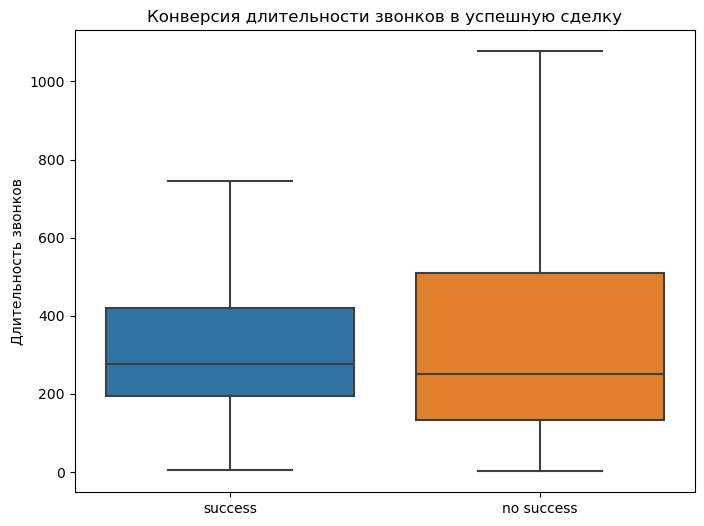

In [21]:
plt.figure(figsize=(8, 6))

sns.boxplot(data=[data6, data7], showfliers=False)

plt.title('Конверсия длительности звонков в успешную сделку')
plt.ylabel('Длительность звонков')
plt.xticks([0, 1], ['success', 'no success']);

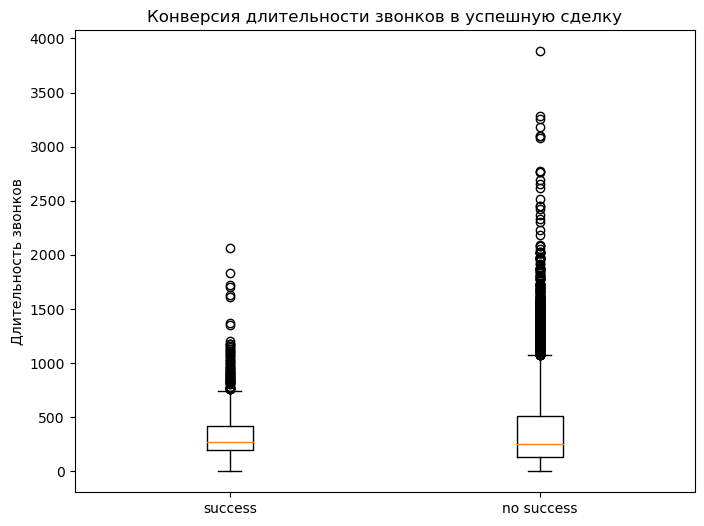

In [22]:
plt.figure(figsize=(8, 6))

plt.boxplot([data6, data7])

plt.title('Конверсия длительности звонков в успешную сделку')
plt.ylabel('Длительность звонков')
plt.xticks([1, 2], ['success', 'no success']);

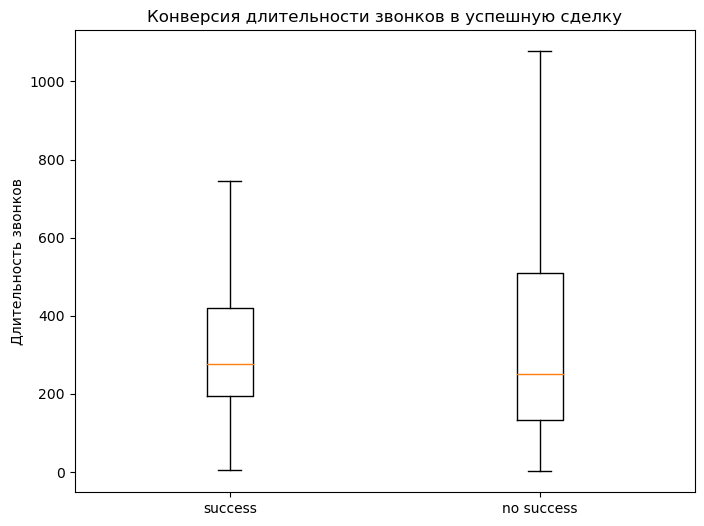

In [23]:
plt.figure(figsize=(8, 6))

plt.boxplot([data6, data7], showfliers=False)

plt.title('Конверсия длительности звонков в успешную сделку')
plt.ylabel('Длительность звонков')
plt.xticks([1, 2], ['success', 'no success']);

#### Круговая диаграмма

In [24]:
data8 = df.poutcome.value_counts()
data8

unknown    8326
failure    1228
success    1071
other       537
Name: poutcome, dtype: int64

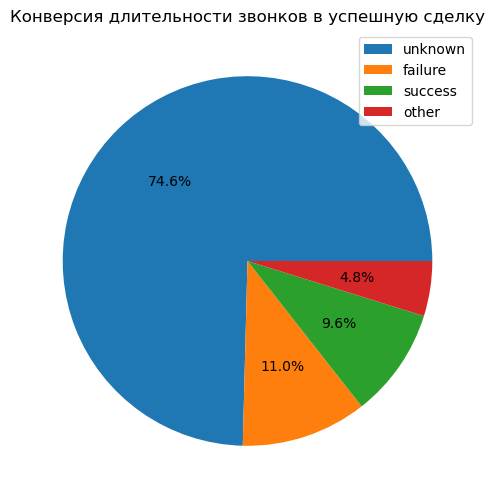

In [25]:
plt.figure(figsize=(8, 6))

plt.pie(data8, autopct='%1.1f%%')

plt.title('Конверсия длительности звонков в успешную сделку')
plt.legend(data8.index);

## Визуальный анализ данных 

In [26]:
df2 = pd.read_csv('kc_house_data.csv')
df2

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
21608,263000018,20140521T000000,360000.0,3,2.50,1530,1131,3.0,0,0,...,8,1530,0,2009,0,98103,47.6993,-122.346,1530,1509
21609,6600060120,20150223T000000,400000.0,4,2.50,2310,5813,2.0,0,0,...,8,2310,0,2014,0,98146,47.5107,-122.362,1830,7200
21610,1523300141,20140623T000000,402101.0,2,0.75,1020,1350,2.0,0,0,...,7,1020,0,2009,0,98144,47.5944,-122.299,1020,2007
21611,291310100,20150116T000000,400000.0,3,2.50,1600,2388,2.0,0,0,...,8,1600,0,2004,0,98027,47.5345,-122.069,1410,1287


In [27]:
pd.DataFrame(df2.price.value_counts()).sort_index()

,price
75000.0,1
78000.0,1
80000.0,1
81000.0,1
82000.0,1
...,...
5350000.0,1
5570000.0,1
6885000.0,1
7062500.0,1


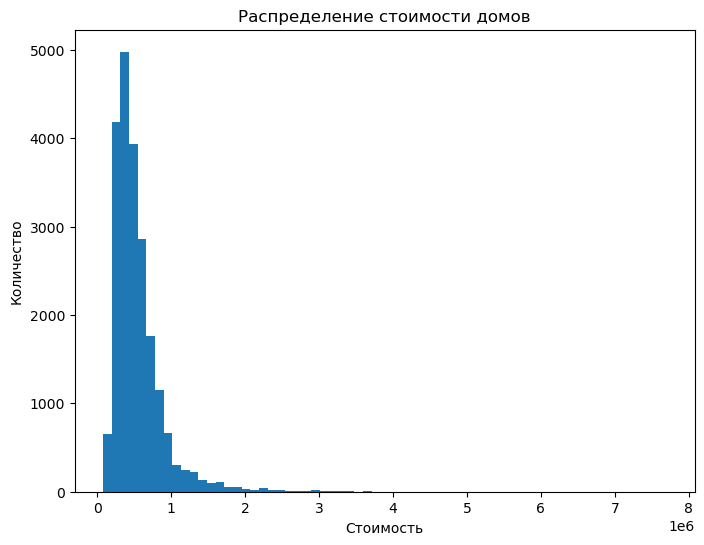

In [28]:
plt.figure(figsize=(8, 6))

plt.hist(df2['price'], bins=65)

plt.title('Распределение стоимости домов')
plt.xlabel('Стоимость')
plt.ylabel('Количество');

In [29]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21613 entries, 0 to 21612
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21613 non-null  int64  
 1   date           21613 non-null  object 
 2   price          21613 non-null  float64
 3   bedrooms       21613 non-null  int64  
 4   bathrooms      21613 non-null  float64
 5   sqft_living    21613 non-null  int64  
 6   sqft_lot       21613 non-null  int64  
 7   floors         21613 non-null  float64
 8   waterfront     21613 non-null  int64  
 9   view           21613 non-null  int64  
 10  condition      21613 non-null  int64  
 11  grade          21613 non-null  int64  
 12  sqft_above     21613 non-null  int64  
 13  sqft_basement  21613 non-null  int64  
 14  yr_built       21613 non-null  int64  
 15  yr_renovated   21613 non-null  int64  
 16  zipcode        21613 non-null  int64  
 17  lat            21613 non-null  float64
 18  long  

In [30]:
df_num_features = df2.select_dtypes(include=['float'])
df_num_features.drop('price', axis=1, inplace=True)

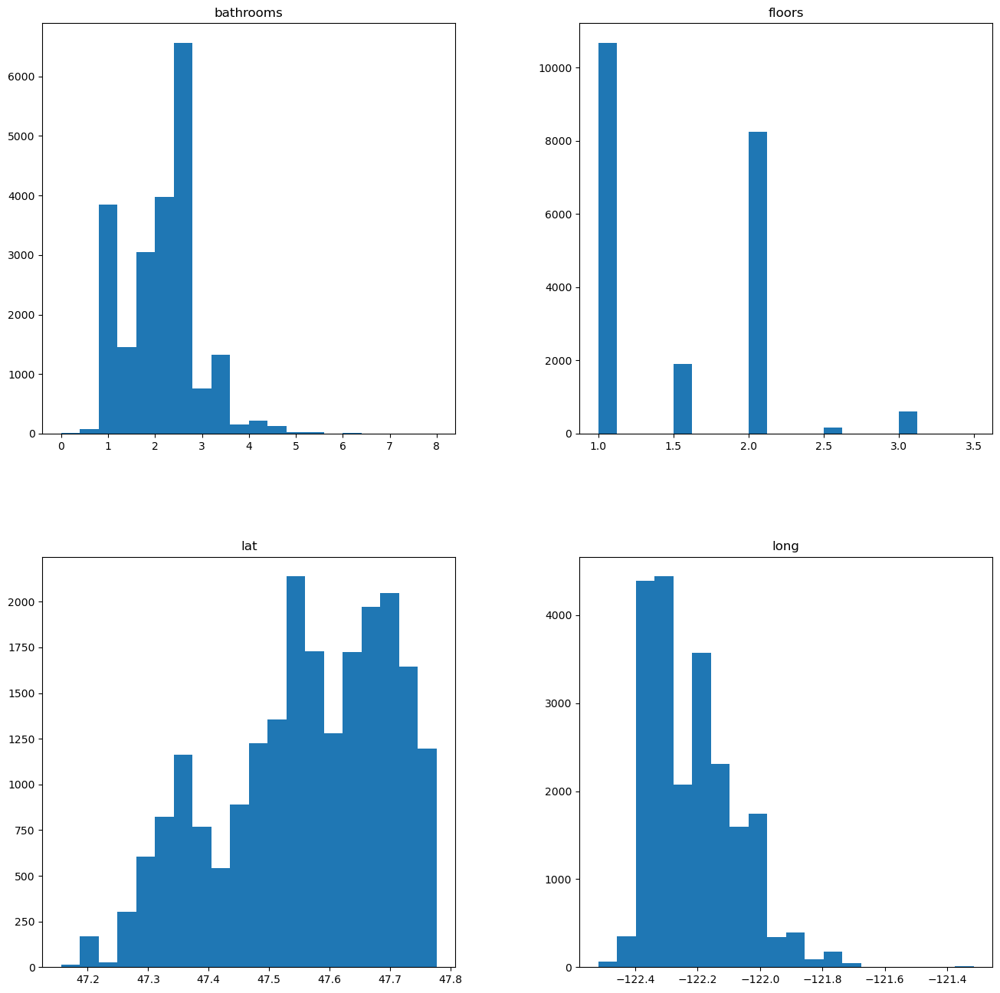

In [31]:
df_num_features.hist(figsize=(16, 16), bins=20, grid=False);

### Поиск выбросов с помощью boxplot

''

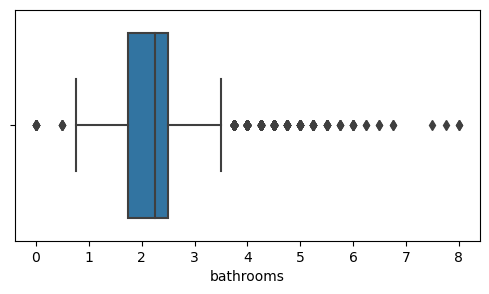

In [32]:
plt.figure(figsize=(6, 3))

sns.boxplot(x=df2.bathrooms, whis=1.5)
;

### Анализ категориальных признаков

In [33]:
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,deposit,month2
0,59,admin.,married,secondary,no,2343,yes,no,unknown,5,may,1042,1,-1,0,unknown,yes,5
1,56,admin.,married,secondary,no,45,no,no,unknown,5,may,1467,1,-1,0,unknown,yes,5
2,41,technician,married,secondary,no,1270,yes,no,unknown,5,may,1389,1,-1,0,unknown,yes,5
3,55,services,married,secondary,no,2476,yes,no,unknown,5,may,579,1,-1,0,unknown,yes,5
4,54,admin.,married,tertiary,no,184,no,no,unknown,5,may,673,2,-1,0,unknown,yes,5


In [34]:
count1 = df.marital.value_counts()

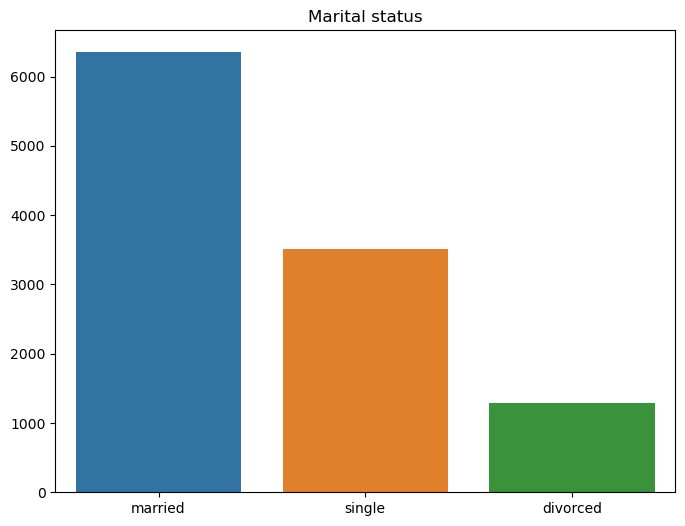

In [35]:
plt.figure(figsize=(8, 6))

plt.title('Marital status')
sns.barplot(x=count1.index, y=count1.values);

## Бинарные признаки

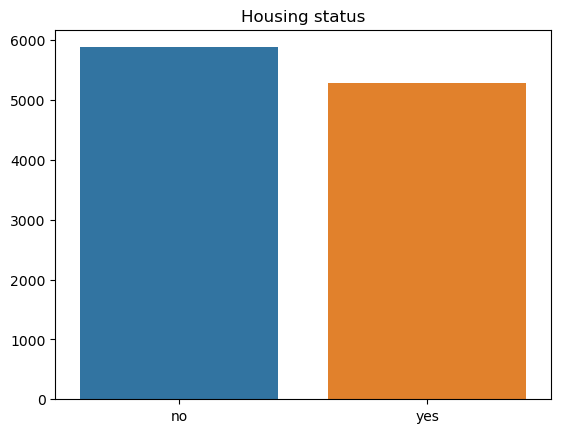

In [36]:
count2 = df.housing.value_counts()

plt.title('Housing status')
sns.barplot(x=count2.index, y=count2.values);

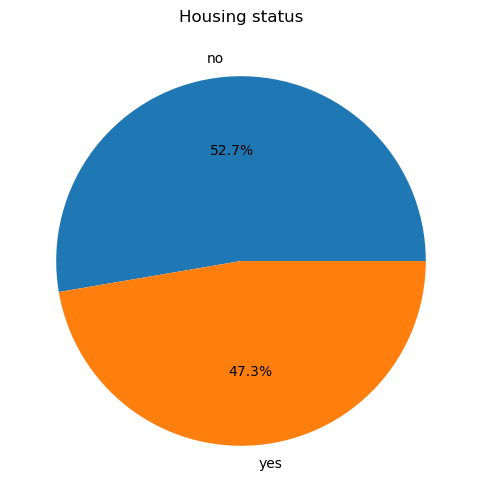

In [37]:
plt.figure(figsize=(8,6))
plt.title('Housing status')
plt.pie(count2.values, labels=count2.index, autopct='%1.1f%%')
plt.legend;

### Анализ взаимных распределений

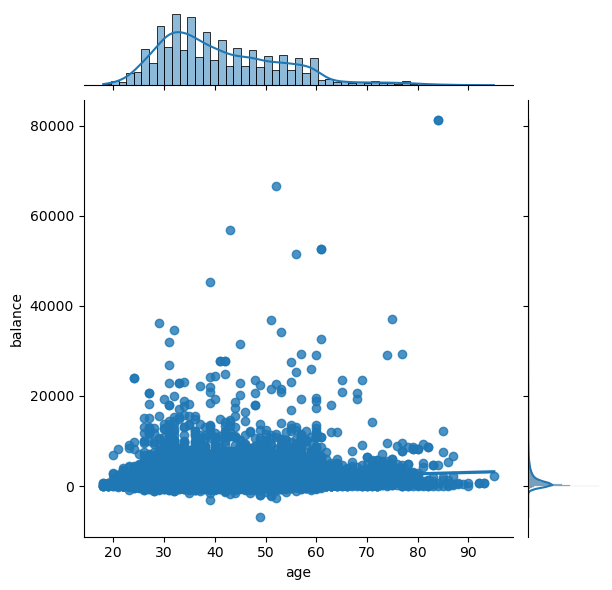

In [38]:
sns.jointplot(x=df.age, y=df.balance, kind='reg');

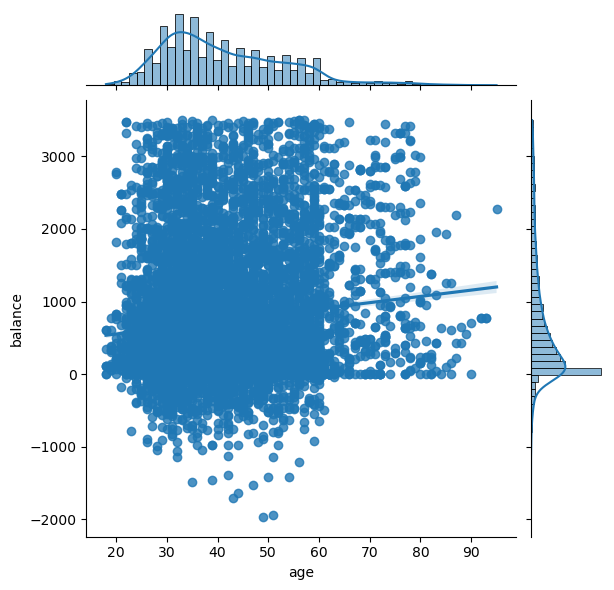

In [39]:
sns.jointplot(x=df.age, y=df.balance[(df.balance < 3500) & (df.balance > -2000)], kind='reg');

In [40]:
# sns.jointplot(x=df2.lat, y=df2.long, kind='kde')

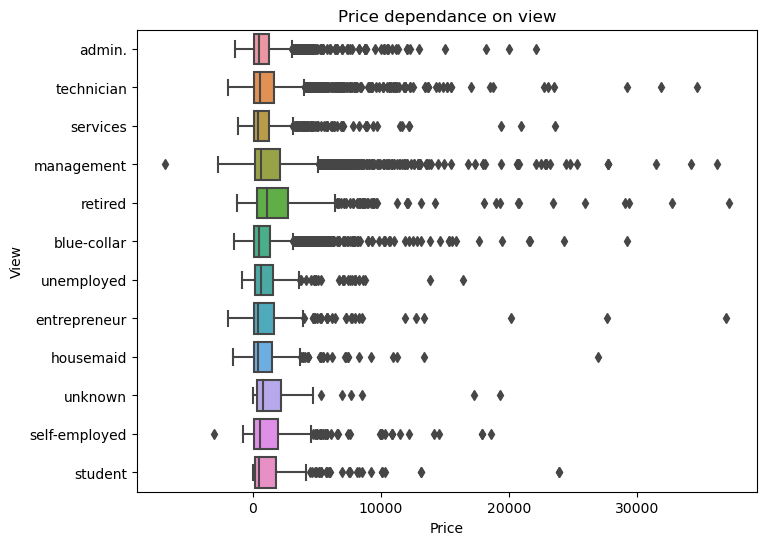

In [47]:
plt.figure(figsize=(8,6))

sns.boxplot(x=df.balance[df.balance < 40000], y=df.job, whis=1.5)

plt.title('Price dependance on view')
plt.xlabel('Price')
plt.ylabel('View')
plt.show;

## Матрица корреляции

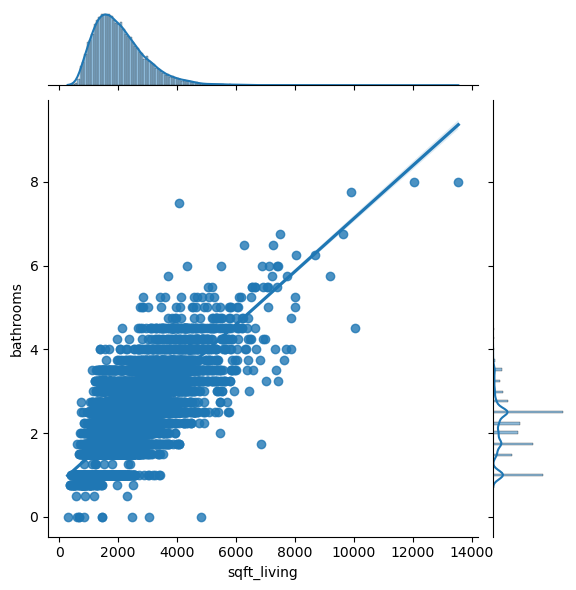

In [56]:
sns.jointplot(x=df2.sqft_living, y=df2.bathrooms, kind='reg');

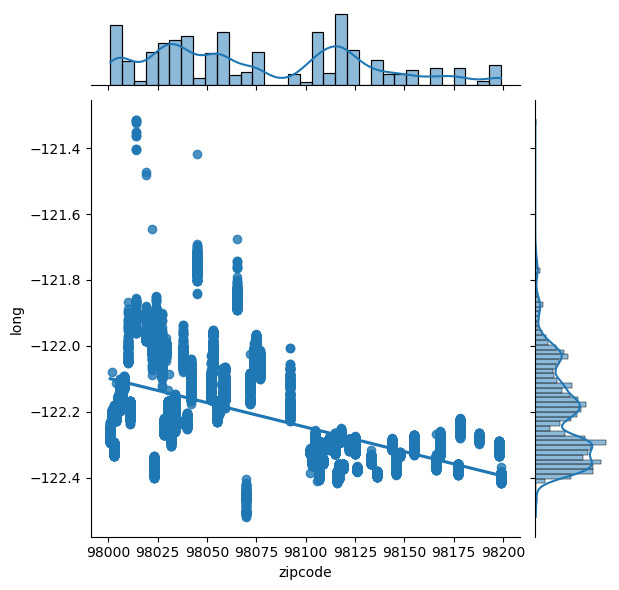

In [57]:
    sns.jointplot(x=df2.zipcode, y=df2.long, kind='reg')

In [55]:
corr_matrix = df2.corr()
corr_matrix = np.round(corr_matrix, 1)
corr_matrix[np.abs(corr_matrix) < 0.3] = 0
corr_matrix

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
id,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
price,0.0,1.0,0.3,0.5,0.7,0.0,0.3,0.3,0.4,0.0,0.7,0.6,0.3,0.0,0.0,0.0,0.3,0.0,0.6,0.0
bedrooms,0.0,0.3,1.0,0.5,0.6,0.0,0.0,0.0,0.0,0.0,0.4,0.5,0.3,0.0,0.0,0.0,0.0,0.0,0.4,0.0
bathrooms,0.0,0.5,0.5,1.0,0.8,0.0,0.5,0.0,0.0,0.0,0.7,0.7,0.3,0.5,0.0,0.0,0.0,0.0,0.6,0.0
sqft_living,0.0,0.7,0.6,0.8,1.0,0.0,0.4,0.0,0.3,0.0,0.8,0.9,0.4,0.3,0.0,0.0,0.0,0.0,0.8,0.0
sqft_lot,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.7
floors,0.0,0.3,0.0,0.5,0.4,0.0,1.0,0.0,0.0,-0.3,0.5,0.5,0.0,0.5,0.0,0.0,0.0,0.0,0.3,0.0
waterfront,0.0,0.3,0.0,0.0,0.0,0.0,0.0,1.0,0.4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
view,0.0,0.4,0.0,0.0,0.3,0.0,0.0,0.4,1.0,0.0,0.3,0.0,0.3,0.0,0.0,0.0,0.0,0.0,0.3,0.0
condition,0.0,0.0,0.0,0.0,0.0,0.0,-0.3,0.0,0.0,1.0,0.0,0.0,0.0,-0.4,0.0,0.0,0.0,0.0,0.0,0.0


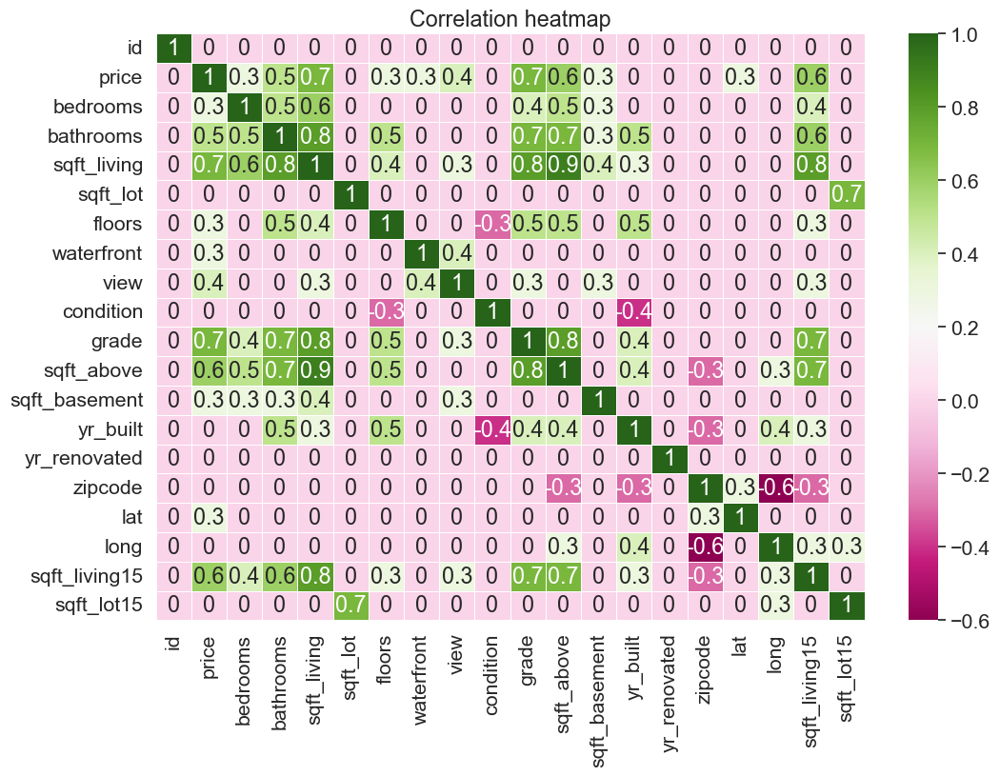

In [77]:
plt.figure(figsize=(12,8))

sns.set(font_scale=1.4)

sns.heatmap(corr_matrix, annot=True, linewidths=0.5, cmap='PiYG')
plt.title('Correlation heatmap');

## Гео-данные

In [80]:
df2.lat.min(), df2.lat.max()

(47.1559, 47.7776)

In [81]:
df2.long.min(), df2.long.max()

(-122.519, -121.315)

In [82]:
import matplotlib.image as img

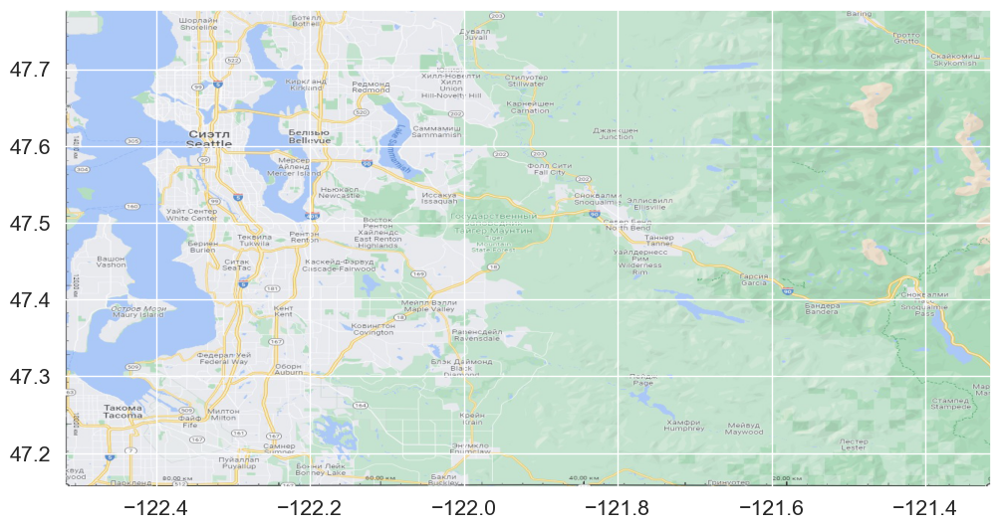

In [93]:
seattle = img.imread('Seattle.jpg')

plt.figure(figsize=(12, 12))
plt.imshow(seattle,
          extent=[df2.long.min(), df2.long.max(), df2.lat.min(), df2.lat.max()], alpha=0.8)

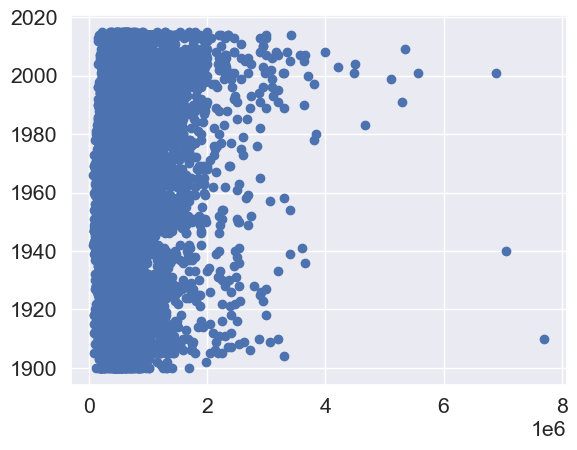

In [122]:
plt.scatter(df2.price, df2.yr_built)

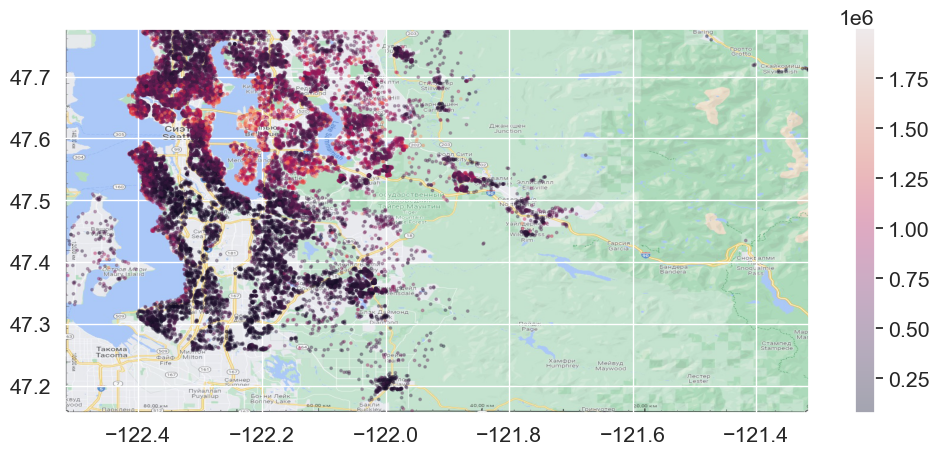

In [134]:
df2_temp = df2[df2.price < 2000000]

plt.figure(figsize=(12, 5))

sc = plt.scatter(df2_temp.long, df2_temp.lat, alpha=0.3, c=df2_temp.price, s=3)

plt.imshow(seattle,
          extent=[df2_temp.long.min(), df2_temp.long.max(), df2_temp.lat.min(), df2_temp.lat.max()], alpha=0.8)

plt.colorbar(sc)

## Folium

In [138]:
import folium

In [145]:
newmap = folium.Map(prefer_canvas=True)

def plotbot(point):
    folium.CircleMarker(
        location=[point.lat, point.long],
        radius=2,
        popup = point.price
    ).add_to(newmap)
    
df2_temp.apply(plotbot, axis=1)

newmap.fit_bounds(newmap.get_bounds())

newmap

## Kepler**

In [149]:
!pip install keplergl

     ---------------------------------------- 9.7/9.7 MB 2.2 MB/s eta 0:00:00
  Installing build dependencies: started
  Installing build dependencies: still running...
  Installing build dependencies: finished with status 'done'
  Getting requirements to build wheel: started
  Getting requirements to build wheel: finished with status 'done'
  Preparing metadata (pyproject.toml): started
  Preparing metadata (pyproject.toml): finished with status 'done'
     ---------------------------------------- 1.1/1.1 MB 1.4 MB/s eta 0:00:00
     ---------------------------------------- 1.4/1.4 MB 1.9 MB/s eta 0:00:00
     ---------------------------------------- 22.0/22.0 MB 1.9 MB/s eta 0:00:00
     ---------------------------------------- 5.1/5.1 MB 1.7 MB/s eta 0:00:00
  Created wheel for keplergl: filename=keplergl-0.3.2-py2.py3-none-any.whl size=17922327 sha256=a82fe520345e19b142f983b04db17e8e215997da1427f1a5cf44fafd1ae846d9
  Stored in directory: c:\users\natal\appdata\local\pip\cache\wheel

In [ ]:
from keplergl import KeplerGl

map2 = KeplerGl(height=700)
map2.add_data(df2, 'Data')

map2.save_to_html(file_name='./seattle.html')